# Style Transfer with a Wasserstein Metric 

This is a pytorch implementation of [Style Transfer as Optimum Transport](https://github.com/VinceMarron/style_transfer) by Vince Marron. 

This technique uses an L2-Wasserstein distance to optimize style transfer from one image to another. Similar to the [Gatys et. al](https://arxiv.org/abs/1508.06576) approach, the content image and the style image are passed through a pretrained convolutional model (in this case VGG16) and the activations of both images at various layers are used as input to the loss function.

Unlike the Gatys approach, this technique does not use a combination of content loss and style loss. There is only one loss function - the L2-Wasserstein metric.

To simplify calculation of the metric, this technique assumes that the activations input into the loss function are multivariate Gaussian distributions modeled by the first two moments. This allows for a very straightforward calculation of the loss.

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import torch, torch.nn.functional as F
from torch import ByteTensor, DoubleTensor, FloatTensor, HalfTensor, LongTensor, ShortTensor, Tensor
from torch import nn, optim, as_tensor
from torch.utils.data import BatchSampler, DataLoader, Dataset, Sampler, TensorDataset
import torchvision
import math, matplotlib.pyplot as plt, numpy as np, pandas as pd, random
import PIL
from torchvision.models import vgg16_bn

In [3]:
from functools import partial

In [4]:
torch.backends.cudnn.benchmark=True

In [5]:
#Forward hooks to grab activations
class SaveFeatures():
    features=None
    def __init__(self, m): self.hook = m.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output): self.features = output
    def close(self): self.hook.remove()

In [6]:
def requires_grad(m, b=None):
    "If `b` is not set return `requires_grad` of first param, else set `requires_grad` on all params as `b`"
    ps = list(m.parameters())
    if not ps: return None
    if b is None: return ps[0].requires_grad
    for p in ps: p.requires_grad=b

In [7]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [8]:
def open_image(fn, convert='RGB'):
    pil_img = PIL.Image.open(fn).convert(convert)
    return pil_img

In [9]:
def pil2tensor(image,dtype=np.float32):
    "Convert PIL style `image` array to torch style image tensor."
    a = np.asarray(image)
    if a.ndim==2 : a = np.expand_dims(a,2)
    a = np.transpose(a, (1, 0, 2))
    a = np.transpose(a, (2, 1, 0))
    return torch.from_numpy(a.astype(dtype, copy=False)).div_(255)

In [10]:
def get_image_tensor(fn, scale=None, content=False):
    pil_img = open_image(fn)
    
    if scale:
        a,b = pil_img.size
        pil_img = pil_img.resize((a//scale, b//scale))
    
    img_tensor = pil2tensor(pil_img)[None].cuda()
    
    if content:
        img_tensor.requires_grad_(True)
        
    return img_tensor

This is the content image that we will transfer style to.

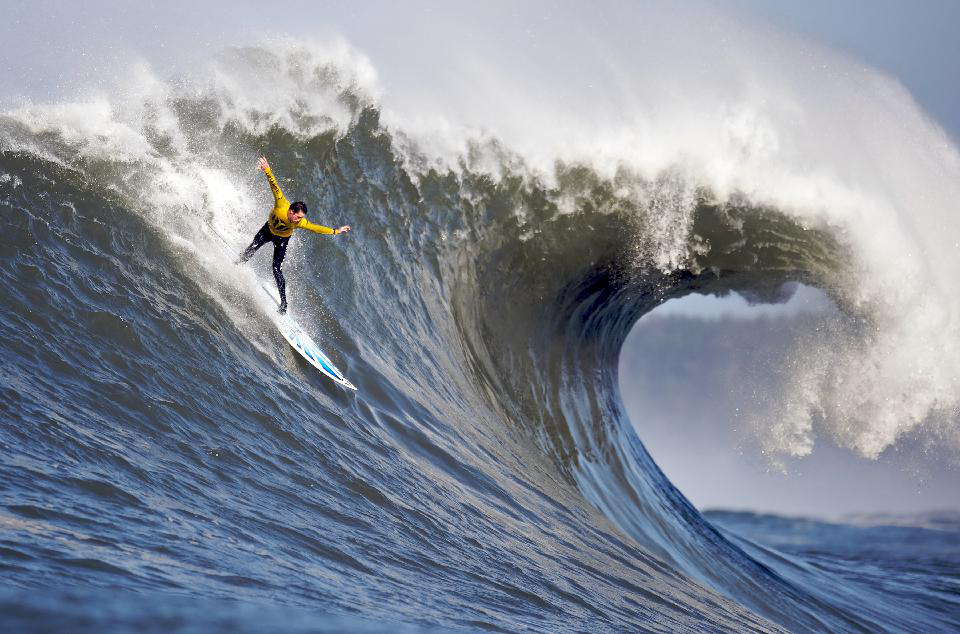

In [11]:
cnt_fn = 'data/styles/wave_small.jpg'
open_image(cnt_fn)

This is the style image. 

The metric we will use looks only at the distribution of extracted activations, so it is not necessary for the content and style images to be the same shape. I have found that style images around 400-800 pixels in size are sufficient to get good transfer - there is no need to work with extremely large images. That said, the size of the style image effects the aesthetic of the final image. Larger style images lead to larger textures, and vice versa.

I have also found that the output images look better if you don't normalize the input images.

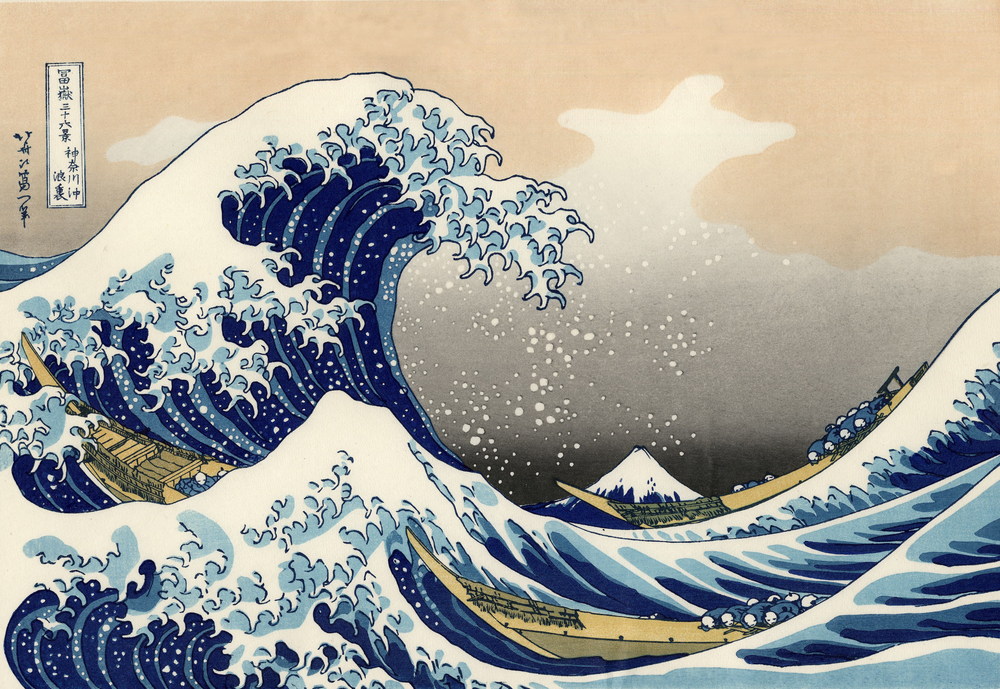

In [12]:
style_fn = 'data/styles/The_Great_Wave_off_Kanagawa.jpg'
open_image(style_fn)

# Wasserstein Loss

For our loss, we calculate the L2-Wasserstein distance between the content activations and the style activations. We can do this in a simple, closed for calculation by taking the mean and covariance of the extracted activations and assuming they are drawn from a multivariate Gaussian distribution. We calculate the loss with this equation:

![text](data/styles/wass_loss.png)

In [13]:
def calc_2_moments(tensor):
    chans = tensor.shape[1]
    tensor = tensor.view(1, chans, -1)
    n = tensor.shape[2]
    
    mu = tensor.mean(2)
    tensor = (tensor - mu[:,:,None]).squeeze(0)
    cov = torch.mm(tensor, tensor.t()) / float(n)
    
    return mu, cov

In [14]:
def get_style_vals(tensor):
    mean, cov = calc_2_moments(tensor)
    
    eigvals, eigvects = torch.symeig(cov, eigenvectors=True)
    
    eigroot_mat = torch.diag(torch.sqrt(eigvals.clamp(min=0)))
    
    root_cov = torch.mm(torch.mm(eigvects, eigroot_mat), eigvects.t())
    
    tr_cov = eigvals.clamp(min=0).sum()
    
    return mean, tr_cov, root_cov

In [15]:
def calc_l2wass_dist(mean_stl, tr_cov_stl, root_cov_stl, mean_synth, cov_synth):
    
    tr_cov_synth = torch.symeig(cov_synth, eigenvectors=True)[0].clamp(min=0).sum()
    
    mean_diff_squared = (mean_stl - mean_synth).pow(2).sum()
    
    cov_prod = torch.mm(torch.mm(root_cov_stl, cov_synth), root_cov_stl)
    
    var_overlap = torch.sqrt(torch.symeig(cov_prod, eigenvectors=True)[0].clamp(min=0)+1e-8).sum()
    
    dist = mean_diff_squared + tr_cov_stl + tr_cov_synth - 2*var_overlap
    
    return dist

In [16]:
def single_wass_loss(pred, targ):
    mean_test, tr_cov_test, root_cov_test = targ
    mean_synth, cov_synth = calc_2_moments(pred)
    loss = calc_l2wass_dist(mean_test, tr_cov_test, root_cov_test, mean_synth, cov_synth)
    return loss

This is the loss function we will use. `m_feat` is the pretrained network we will use to extract activations - in this case VGG16. `layer_ids` are the index values of the actual layers of `m_feat` we use to get activations. Using different layers has a strong effect on the resulting image. See the `style_transfer_experiments` notebook for more detail. `layer_wgts` allows for weighting of different layers. `style_imgs` allows for multiple style images as input, weighted by `style_wgts`.

In [17]:
class WassLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts, style_imgs, style_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.layer_ids = layer_ids
        self.layer_wgts = layer_wgts
        self.style_wgts = style_wgts
        
        self.sfs = [SaveFeatures(m_feat[idx]) for idx in self.layer_ids]
        
        self.styles = []
        
        for im in style_imgs:
            out_feat = self.make_features(im)
            self.styles.append([get_style_vals(i) for i in out_feat])
            
    def make_features(self, x):
        self.m_feat(x)
        targ_feats = [o.features.clone().detach().requires_grad_(False) for o in self.sfs]
        return targ_feats
    
    def forward(self, input):
        self.m_feat(input)
        in_feat = [o.features for o in self.sfs]
        
        self.img_losses = []
        
        for i, styles in enumerate(self.styles):
            feat_losses = [single_wass_loss(f_pred, f_targ)*w
                              for f_pred, f_targ, w in zip(in_feat, styles, self.layer_wgts)]
            self.img_losses.append(self.style_wgts[i]*sum(feat_losses))
            
        return sum(self.img_losses)

# Style Transfer

Here is where we actually do the style transfer. For this example, we will use 6 convolution layers for our activation source. We optimize with LBFGS. For most cases, 250-500 iterations is sufficient to get good style transfer.

In [18]:
def style_transfer(fn_content, styles, style_weights, blocks, block_weights, iterations=250, cnt_scale=1):
    cnt_tensor = get_image_tensor(fn_content, scale=cnt_scale, content=True)
    feat_loss = WassLoss(vgg_m, blocks, block_weights, styles, style_weights)
    opt = optim.LBFGS([cnt_tensor])
    
    n_iter = [0]
    while n_iter[0] <= iterations:
        
        def closure():
            opt.zero_grad()
            loss = feat_loss(cnt_tensor)
            loss.backward()
            
            n_iter[0] += 1
            if n_iter[0]%125 == 0:
                print(f'Iteration: {n_iter[0]}, loss: {loss.item()}')
            
            return loss
        
        opt.step(closure)
    
    im = np.rollaxis(cnt_tensor.detach().cpu()[0].clamp(0,1).numpy(), 0, 3)
    
    return im

In [19]:
style1 = get_image_tensor(style_fn, scale=4)

In [20]:
block_ends = [3, 7, 10, 14, 17, 20]
block_weights = [1]*len(block_ends) #for this example we weight each layer equally

In [21]:
im = style_transfer(cnt_fn, [style1], [1], block_ends, block_weights)

Iteration: 125, loss: 0.014607906341552734
Iteration: 250, loss: -0.005825519561767578


And the style is transferred!

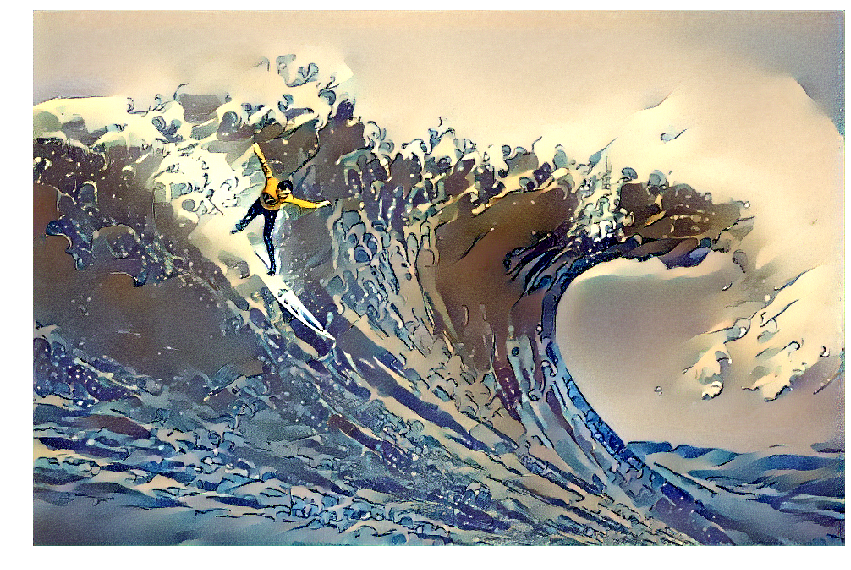

In [22]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
plt.imshow(im)
plt.axis('off');

# Example 2

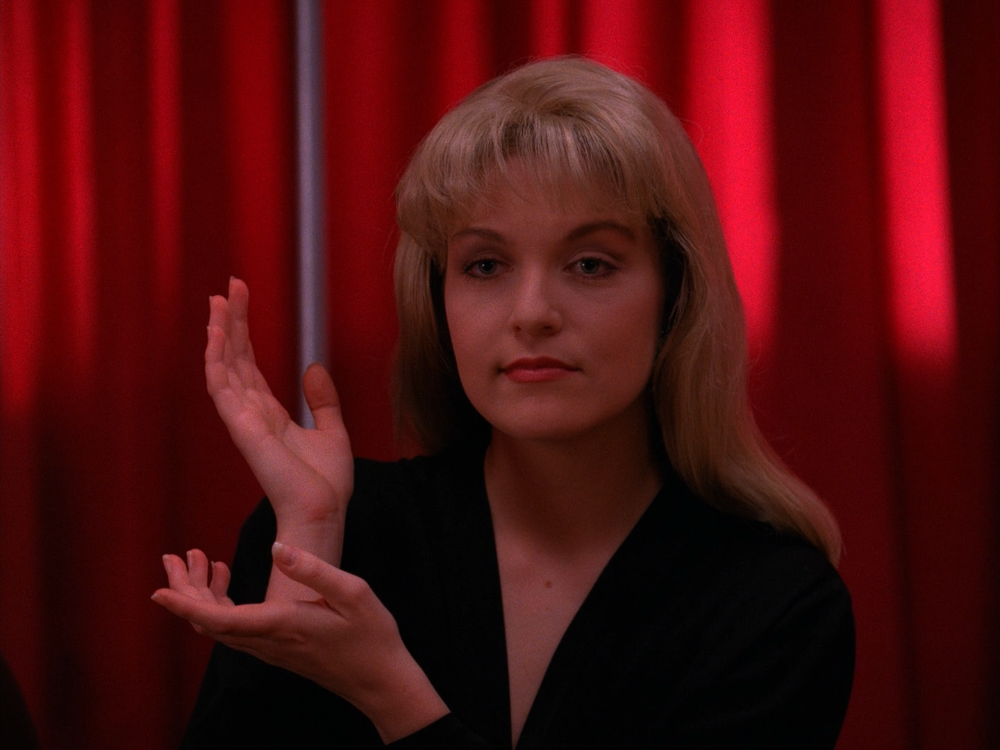

In [21]:
cnt_fn = 'data/styles/laura.png'
open_image(cnt_fn)

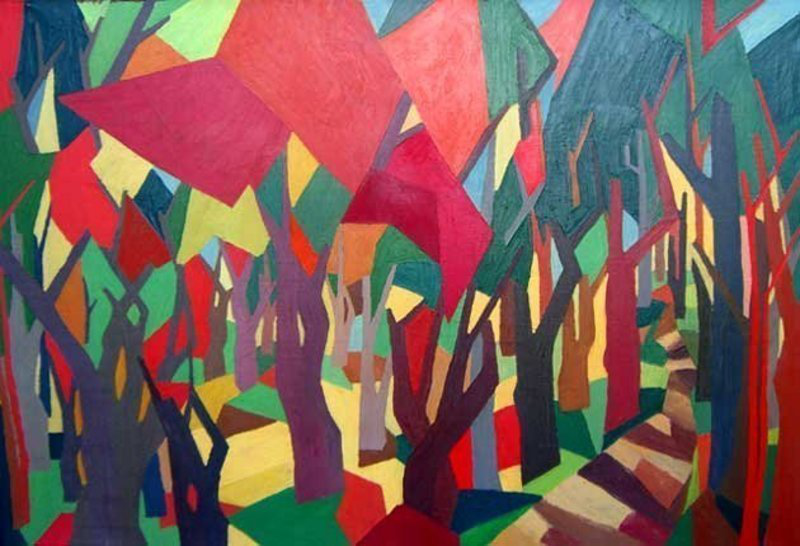

In [22]:
style_fn = 'data/styles/modernist.jpg'
open_image(style_fn)

In [23]:
style2 = get_image_tensor(style_fn)

In [24]:
im = style_transfer(cnt_fn, [style2], [1], block_ends, block_weights, cnt_scale=2)

Iteration: 125, loss: 0.14989781379699707
Iteration: 250, loss: 0.048813700675964355


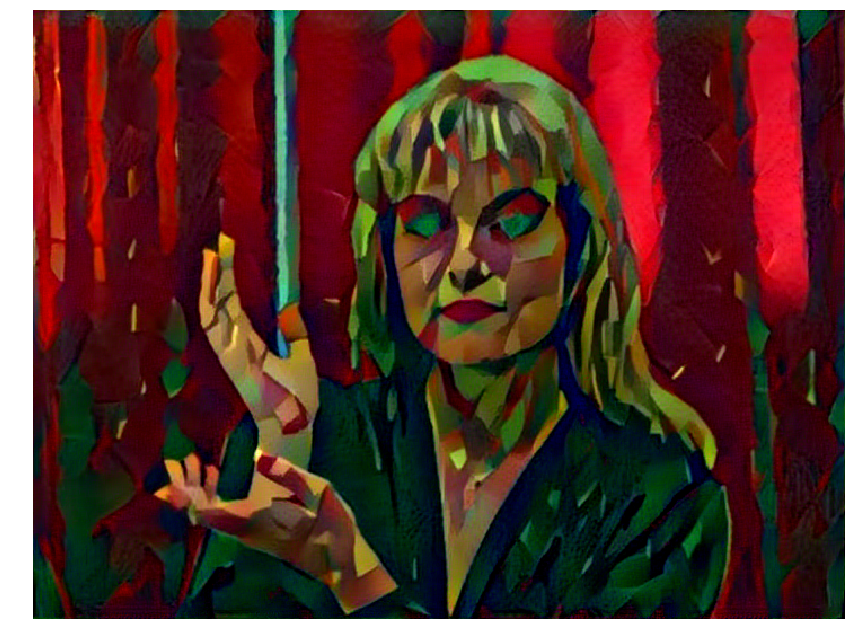

In [25]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
plt.imshow(im)
plt.axis('off');

# Example 3

Style transfer with two images

In [28]:
im = style_transfer(cnt_fn, [style1, style2], [1,1], block_ends, block_weights, cnt_scale=2)

Iteration: 125, loss: 15.808731079101562
Iteration: 250, loss: 15.605184555053711


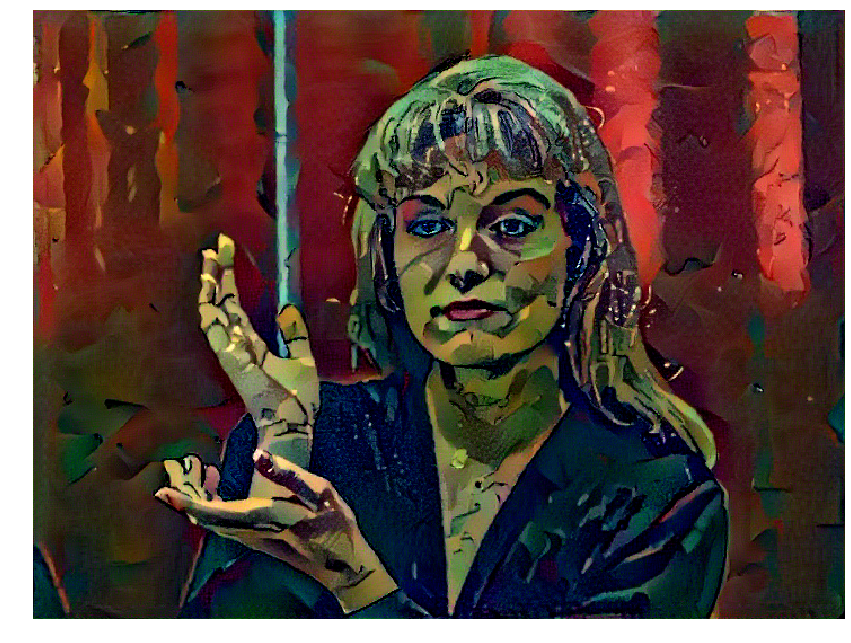

In [29]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
plt.imshow(im)
plt.axis('off');

In [30]:
im = style_transfer(cnt_fn, [style1, style2], [.2,.8], block_ends, block_weights, cnt_scale=2)

Iteration: 125, loss: 5.079283714294434
Iteration: 250, loss: 4.982974052429199


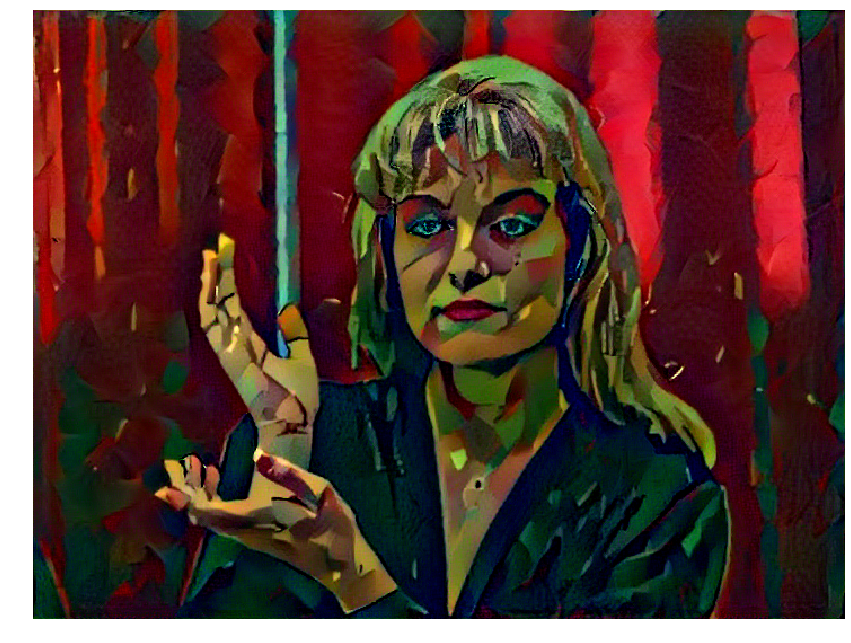

In [31]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
plt.imshow(im)
plt.axis('off');

In [32]:
im = style_transfer(cnt_fn, [style1, style2], [.8,.2], block_ends, block_weights, cnt_scale=2)

Iteration: 125, loss: 5.095454216003418
Iteration: 250, loss: 4.990511894226074


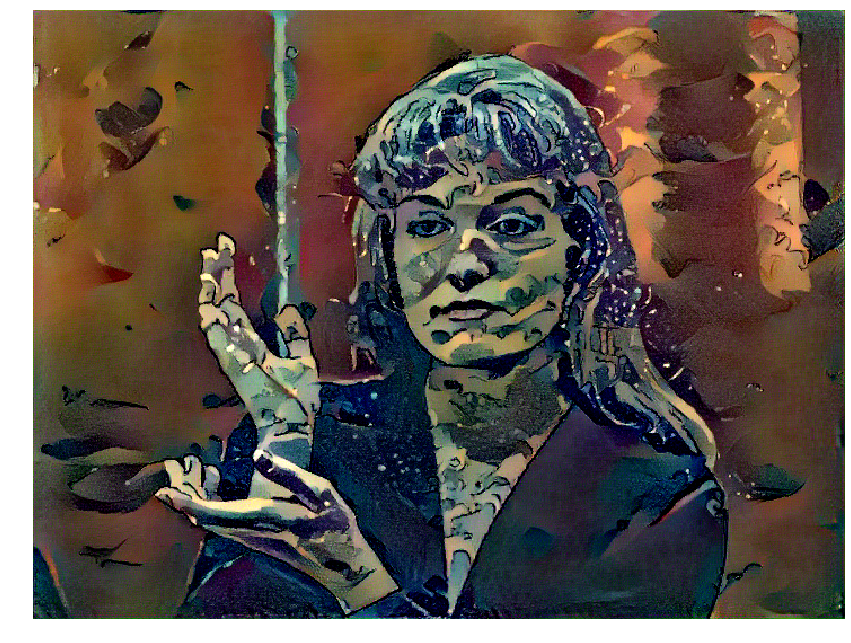

In [33]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
fig.tight_layout()
plt.imshow(im)
plt.axis('off');

# Style Experiments

Different choices of activations and optimizers produce different results. See the `style_transfer_experiments` notebook for more details.

# Effect of Activation Type

Using different types of activations (conv layers, batchnorm layers, ReLU layers) produces different aesthetic results

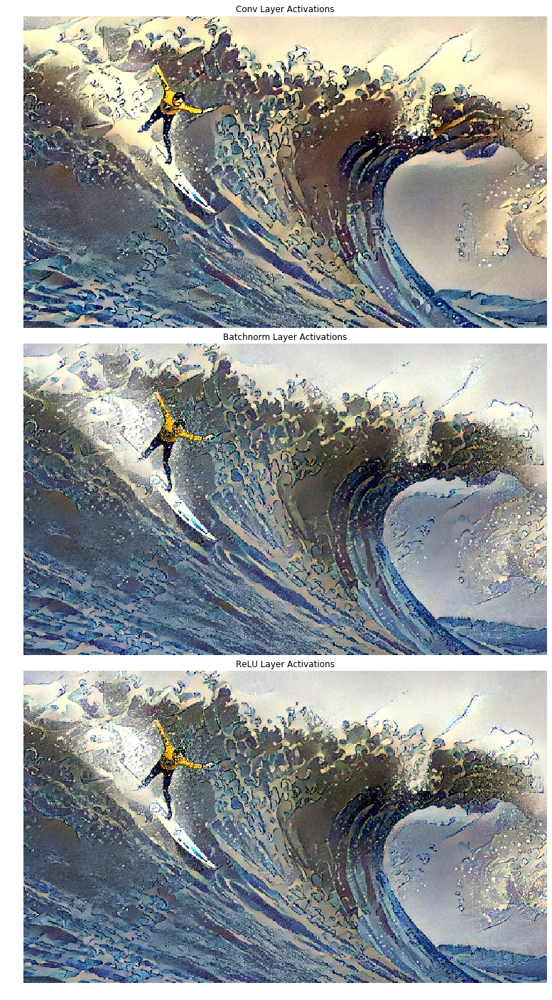

In [46]:
im1 = plt.imread('styles/conv_all_lbfgs.jpg')
im2 = plt.imread('styles/bn_all_lbfgs.jpg')
im3 = plt.imread('styles/relu_all_lbfgs.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('Conv Layer Activations')

axes[1].imshow(im2)
axes[1].set_title('Batchnorm Layer Activations')

axes[2].imshow(im3)
axes[2].set_title('ReLU Layer Activations');

# Effect of Layer Depth

Using earlier or later activations from the convolutional model results in different styles.

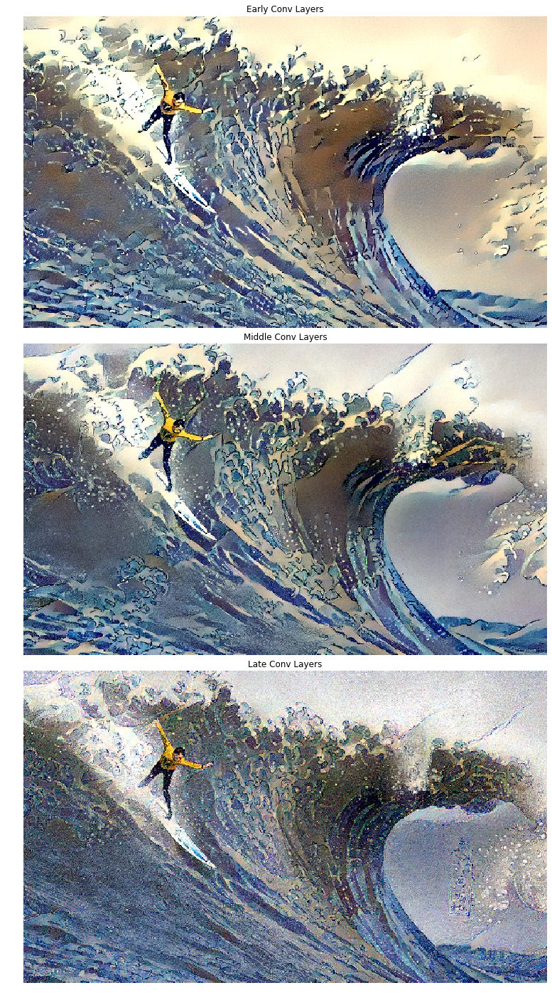

In [45]:
im1 = plt.imread('styles/conv_early_lbfgs.jpg')
im2 = plt.imread('styles/conv_middle_lbfgs.jpg')
im3 = plt.imread('styles/conv_late_lbfgs.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('Early Conv Layers')

axes[1].imshow(im2)
axes[1].set_title('Middle Conv Layers')

axes[2].imshow(im3)
axes[2].set_title('Late Conv Layers');

# Effect of Optimizer 

Different optimizers produce different results. LBFGS seems to converge the fastest and give the cleanest images.

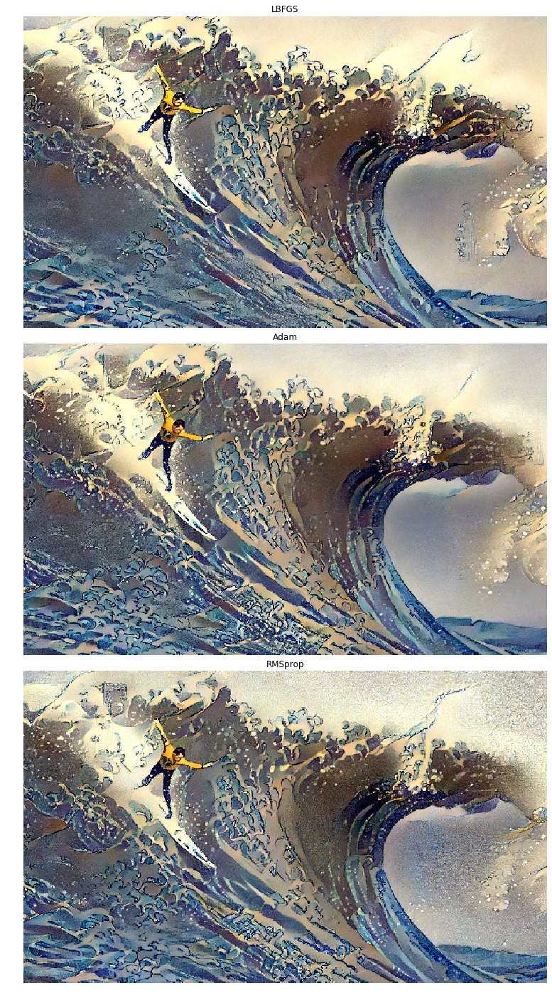

In [47]:
im1 = plt.imread('styles/conv_all_lbfgs.jpg')
im2 = plt.imread('styles/conv_all_adam.jpg')
im3 = plt.imread('styles/conv_all_rms.jpg')

fig, axes = plt.subplots(3, 1, figsize=(15,25))

fig.subplots_adjust(hspace=0.05)

for ax in axes:
    ax.set_axis_off()

axes[0].imshow(im1)
axes[0].set_title('LBFGS')

axes[1].imshow(im2)
axes[1].set_title('Adam')

axes[2].imshow(im3)
axes[2].set_title('RMSprop');